In [1]:
from anndata import read_h5ad
import pandas as pd
import numpy as np
import scvi
import scanpy as sc

%load_ext nb_black
use_cuda = True


In [2]:
import matplotlib.pyplot as plt

%matplotlib inline

In [3]:
data_path = "../TabulaSapiensData/"

In [4]:
adata = read_h5ad(data_path + "decontX/Pilot1_Pilot2.decontX.h5ad")

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9002. The TBB threading layer is disabled.
  warnings.warn(problem)
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


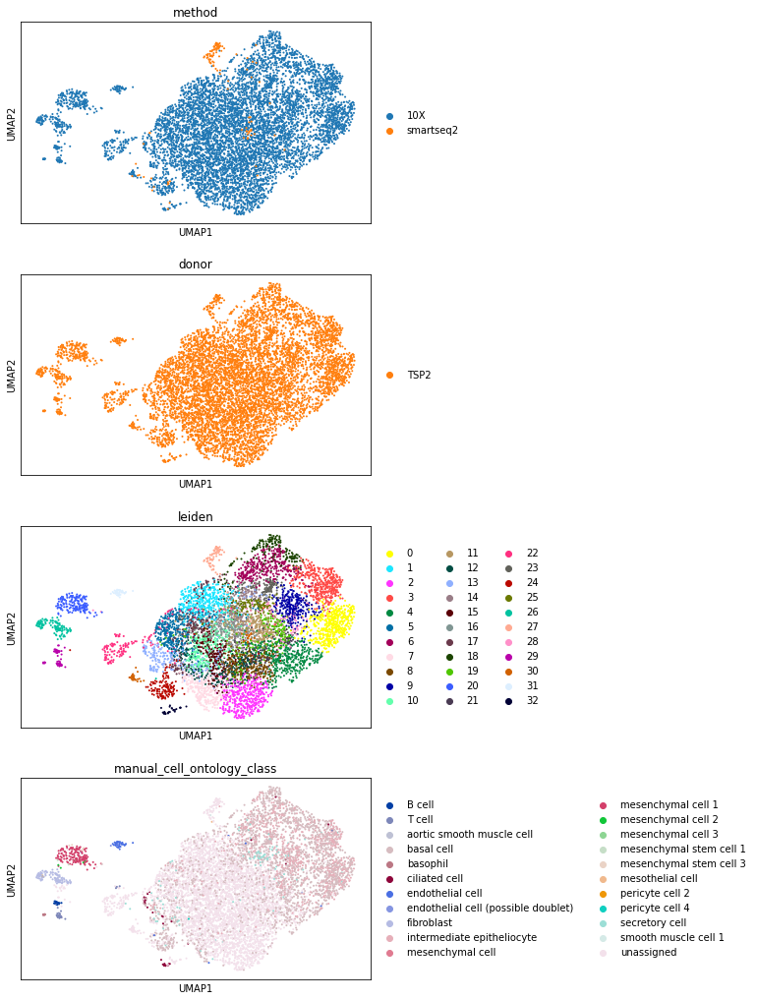

In [5]:
organ = "Trachea"
organ_adata = adata[adata.obs["tissue"] == organ]
sc.pp.neighbors(organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(organ_adata)
organ_adata.obsm["X_umap_decontX"] = organ_adata.obsm["X_umap"].copy()
sc.tl.leiden(organ_adata, resolution=2)
sc.pl.umap(
    organ_adata,
    color=["method", "donor", "leiden", "manual_cell_ontology_class"],
    ncols=1,
)
organ_adata.X = np.log1p(organ_adata.X)

# cluster to celltype correspondance
count is a matrix of cluster-cell type correspondance, where each row is a celltype, and each colum is a cluster. The entries to the matrix is the number of cells that is annotated as celltype *X* and cluster *Y*

In [6]:
count = {}
for c in np.unique(organ_adata.obs["leiden"]):
    count[c] = {}
    for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
        count[c][t] = np.sum(
            (organ_adata.obs["leiden"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )

count = pd.DataFrame.from_dict(count)

We can visualize the cluster assignment of each cell type through this heatmap. The color is normalized for each celltype 

<AxesSubplot:>

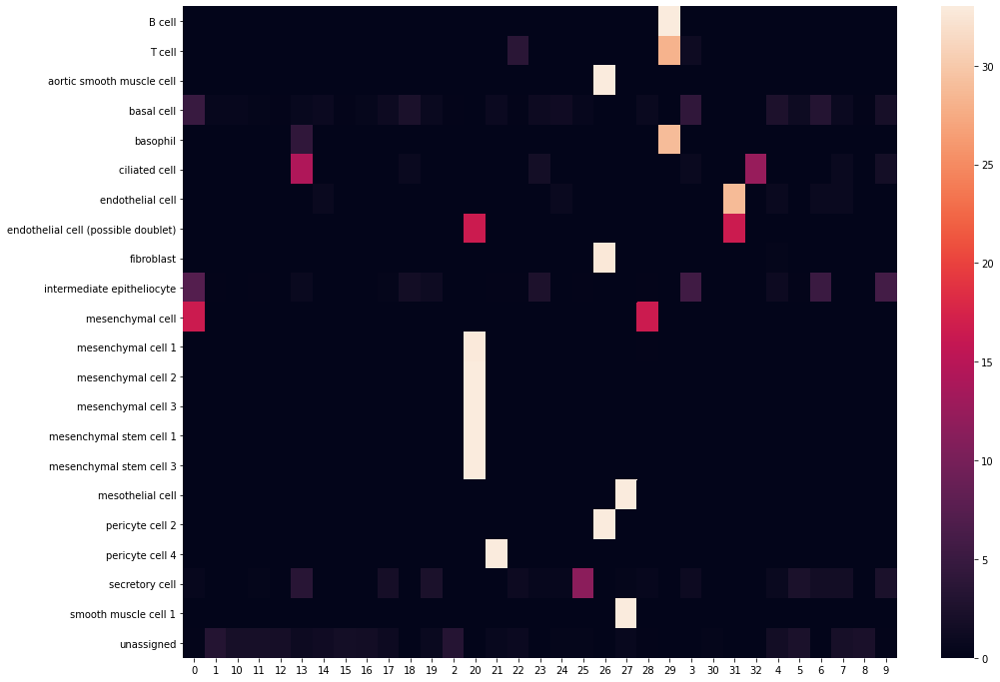

In [7]:
import seaborn

plt.figure(figsize=(16, 12))
seaborn.heatmap((count.T / count.mean(axis=1)).T)

# dictionary of cell type composition of each cluster 
What are clusters previously annotated as 

In [8]:
cluster_composition = {}
for x in count.columns.values:
    t = count.index[count[x] > 0].values
    freq = np.asarray([count.loc[y, x] for y in t]) / count[x].sum()
    res = [a + ": %.2f" % b for a, b in zip(t, freq)]
    cluster_composition[x] = res

In [9]:
cluster_composition["0"]

['basal cell: 0.63',
 'intermediate epitheliocyte: 0.34',
 'mesenchymal cell: 0.00',
 'secretory cell: 0.00',
 'unassigned: 0.03']

# Reassign pure clusters
If a cluster is very pure (>95% of annotated cells come from the same celltype, we reassign the clusters to all have the same labels) 

In [10]:
def Purity(x):
    names = x.index
    x = np.asarray(x).ravel()
    x = x[names != "unassigned"]
    return (np.max(x) / np.sum(x), names[np.argmax(x)])

In [11]:
cluster_purity = count.apply(Purity, axis=0).T
confident_clusters = cluster_purity[cluster_purity[0] > 0.95].index

<ipython-input-1-963029a66ab7>:5: RuntimeWarning: invalid value encountered in long_scalars
  return (np.max(x) / np.sum(x), names[np.argmax(x)])


In [12]:
for i in confident_clusters:
    organ_adata.obs.loc[
        organ_adata.obs["leiden"] == i, "new_manual_cell_ontology_class"
    ] = cluster_purity.loc[i, 1]

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'new_manual_cell_ontology_class' as categorical


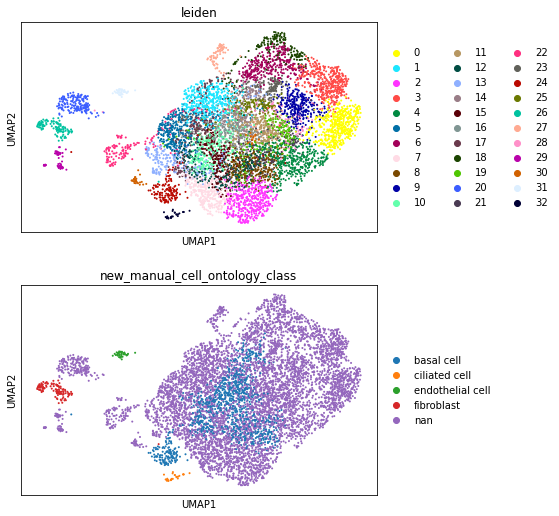

In [13]:
sc.pl.umap(
    organ_adata,
    color=["leiden", "new_manual_cell_ontology_class"],
    ncols=1,
)

# Sankey Diagram between cluster and cell types

In [14]:
from utils.colorDict import donor_colors, method_colors, compartment_colors, tissue_colors

In [15]:
from utils.plotting_utils import *
from utils.colorDict import compartment_colors

import plotly
import chart_studio.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

import plotly.io as pio

pio.renderers.default = "notebook"

init_notebook_mode(connected=True)

In [16]:
df = pd.DataFrame(columns=["celltype", "compartment", "count"])
for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
    for c in np.unique(organ_adata.obs["compartment_pred_svm"]):
        x = np.sum(
            (organ_adata.obs["compartment_pred_svm"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )
        df = df.append(
            pd.DataFrame([t, c, x], index=["celltype", "compartment", "count"]).T,
            ignore_index=True,
        )


fig = genSankey(
    df,
    cat_cols_color=[compartment_colors(), "#00A1E0"],
    cat_cols=["compartment", "celltype"],
    value_cols="count",
    title="celltype-compartment",
)
iplot(fig, validate=False)
plotly.offline.plot(
    fig, validate=False, filename="figures/celltype_sankey_%s" % organ + ".html"
)  # , output_type='div')

'figures/celltype_sankey_Trachea.html'

# visualize compartment markers

In [17]:
compartment_markers = {
    "Epithelial": ["CDH1", "CLDN4", "EPCAM"],
    "Endothelial": ["CA4", "CDH5", "CLDN5", "PECAM1", "VWF"],
    "Stromal": ["BGN", "DCN", "COL1A2"],
    "Immune": ["LCP1", "PTPRC", "RAC2"],
}

In [18]:
for x in compartment_markers.keys():
    sc.tl.score_genes(organ_adata, compartment_markers[x], score_name="%s_score" % x)

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



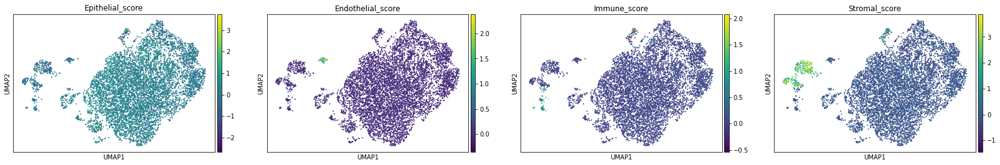

In [19]:
sc.pl.umap(
    organ_adata,
    color=["Epithelial_score", "Endothelial_score", "Immune_score", "Stromal_score"],
)

# Find markers for each cluster

In [20]:
sc.tl.rank_genes_groups(organ_adata, groupby="leiden", method="wilcoxon")

In [21]:
def FormatDE(res):
    groups = res['scores'].dtype.names
    df_res = {}
    for group in groups:
        df = pd.DataFrame([res['scores'][group],
                           res['logfoldchanges'][group],res['pvals_adj'][group]], 
                           columns=res['names'][group],
                           index=['wilcoxon_score','log fold change','adjusted pvalue'])
        df_res[group] = df
    return df_res


In [22]:
DE = FormatDE(organ_adata.uns["rank_genes_groups"])

### top positive marker genes

In [23]:
for x in DE.keys():
    print(x)
    display(DE[x].T[:20])

0


,wilcoxon_score,log fold change,adjusted pvalue
KRT15,24.350584,2.381454,1.682317e-126
BCAM,23.277498,2.268162,1.102942e-115
MIR205HG,19.550871,1.522509,2.170380e-81
GAS5,16.947042,1.453657,6.618898e-61
IGFBP2,16.836163,1.465742,4.107246e-60
ZFP36L2,16.419153,1.364610,3.570621e-57
SERPINF1,15.303896,1.417600,1.630563e-49
TP63,15.072364,1.249215,5.366911e-48
CIRBP,14.886327,1.240120,8.209011e-47
RPLP1,14.735992,1.137178,7.429265e-46


1


,wilcoxon_score,log fold change,adjusted pvalue
KRT6A,19.670458,2.133048,2.274038e-81
KRT14,17.650488,2.060614,1.979631e-65
S100A2,17.398649,1.735090,1.243225e-63
MTATP6P1,16.629753,1.183125,4.996228e-58
KRT13,16.456446,1.847167,7.398065e-57
LY6D,16.053640,2.054749,4.533645e-54
MT-ATP6,16.004696,1.041171,8.719554e-54
S100A9,15.200979,1.477415,2.050889e-48
FGFBP1,14.480518,1.145802,8.609956e-44
MT-ND3,13.937983,0.934851,1.826515e-40


2


,wilcoxon_score,log fold change,adjusted pvalue
MALAT1,16.800638,1.305733,7.106607e-59
NEAT1,14.180596,0.931185,6.510073e-42
GOLGB1,14.179729,1.132016,6.510073e-42
PPP1R15A,13.609431,1.446614,1.480033e-38
JUN,12.575726,0.968097,9.914495e-33
XIST,11.873524,0.804017,3.826016e-29
DST,11.803265,0.858763,8.501259e-29
HNRNPU,11.412109,0.777961,6.332695e-27
FTX,11.192443,1.176061,6.878914e-26
SYNE2,10.684443,0.792933,1.610500e-23


3


,wilcoxon_score,log fold change,adjusted pvalue
MMP10,24.879480,3.722044,7.305458e-132
ID1,22.615772,2.235336,8.924103e-109
TNFRSF12A,21.654175,2.349303,1.089420e-99
IFITM3,20.291117,1.808843,2.267324e-87
BCAM,18.012976,1.835776,1.814579e-68
KRT17,17.924526,1.686446,7.446476e-68
MT2A,16.846870,1.795728,8.139803e-60
IFITM2,16.173494,1.463222,4.566619e-55
UGCG,15.718194,1.601315,6.074997e-52
ETS2,15.313269,1.263596,3.058777e-49


4


,wilcoxon_score,log fold change,adjusted pvalue
KRT15,19.449160,1.894986,1.744005e-79
MIR205HG,16.225182,1.386115,9.852532e-55
BCAM,15.013742,1.449155,1.171175e-46
XIST,14.252139,1.085416,4.265697e-42
GABPB1-AS1,14.070962,1.244229,3.747082e-41
PTPRZ1,13.848643,1.263263,7.631730e-40
RASSF6,13.491935,1.634459,7.900466e-38
TXNIP,13.256827,0.994006,1.732291e-36
DST,13.120146,1.180690,8.742184e-36
MRTFB,12.907831,1.395153,1.264057e-34


5


,wilcoxon_score,log fold change,adjusted pvalue
MT-ATP6,19.388098,1.433732,5.726208e-79
MT-ND3,19.309128,1.458230,1.324920e-78
MTATP6P1,19.156200,1.541990,1.686049e-77
MT-ND4,18.393330,1.279119,2.186561e-71
MT-ND1,17.147549,1.178035,7.719148e-62
MT-CO2,17.010509,1.205852,6.734612e-61
SERPINB3,16.964443,1.502847,1.265855e-60
MT-CYB,16.727695,1.118059,6.060948e-59
MT-CO3,16.523087,1.117243,1.636970e-57
MT-ND2,16.373642,1.078141,1.736791e-56


6


,wilcoxon_score,log fold change,adjusted pvalue
S100A2,25.145727,3.897586,9.264723e-135
S100A10,24.796396,3.374129,2.885907e-131
SFN,24.571260,3.190128,5.030354e-129
TUBA1C,24.129366,2.926738,1.809864e-124
RAN,23.707163,2.818880,3.581268e-120
GAPDH,23.624897,2.689645,2.098481e-119
ENO1,23.561646,2.535147,8.020736e-119
FGFBP1,23.345814,3.289804,1.118496e-116
TXNDC17,23.185930,2.736953,4.130028e-115
PLP2,22.957682,2.733763,7.269822e-113


7


,wilcoxon_score,log fold change,adjusted pvalue
MUC16,17.122202,2.236466,5.967536e-61
NEAT1,15.203014,1.342069,9.940624e-48
SERPINB3,15.120262,1.436363,2.336503e-47
GOLGB1,12.910846,1.331886,5.754321e-34
MT-ND5,12.686649,0.953544,8.256162e-33
MT-ND4L,12.346847,1.040357,4.970444e-31
MUC4,12.284240,1.291218,9.257261e-31
ALCAM,12.155248,1.246671,3.958906e-30
ANKRD36C,12.062673,2.005338,1.087771e-29
ABCA13,12.004036,1.497736,1.992070e-29


8


,wilcoxon_score,log fold change,adjusted pvalue
LRRC75A,3.128614,0.281443,0.060964
CLCA2,2.539392,0.176143,0.273984
C1orf56,2.110021,0.254005,0.652973
ABCA13,1.998853,0.141987,0.798451
CENPF,1.920108,0.438129,0.918021
TSIX,1.841179,0.620754,1.000000
MT-ND6,1.814809,-0.078412,1.000000
TOP2A,1.675856,0.369280,1.000000
DDIT4-AS1,1.563727,1.245762,1.000000
CMYA5,1.516967,0.216855,1.000000


9


,wilcoxon_score,log fold change,adjusted pvalue
KRT19,19.958290,2.778895,7.475536e-84
CALML3,19.760338,3.855307,1.924028e-82
EPHX1,19.363853,3.213933,3.057026e-79
PRSS23,19.284477,2.610994,9.855492e-79
PPDPF,19.277058,2.691902,9.855492e-79
SLC25A5,18.964035,2.657974,3.318125e-76
TXN,18.862398,2.659464,1.954765e-75
CD9,18.755032,2.492798,1.295989e-74
DAPL1,18.692495,3.533625,3.727471e-74
ATP5MC2,18.579226,2.669036,2.786254e-73


10


,wilcoxon_score,log fold change,adjusted pvalue
KRT13,14.344523,1.785628,6.787060e-42
KRT6A,13.337556,1.671181,4.120118e-36
LY6D,11.428700,1.390426,5.898270e-26
DSP,10.655596,0.978616,2.416466e-22
ANXA1,10.511678,0.846168,8.986330e-22
EMP1,10.484576,1.180723,9.978475e-22
LRRC75A,10.265117,0.988225,8.510798e-21
KRT14,10.115695,1.294758,3.463492e-20
SERPINB3,9.942484,0.921790,1.778926e-19
S100A2,9.854459,1.148048,3.856513e-19


11


,wilcoxon_score,log fold change,adjusted pvalue
MT-ND3,12.526643,1.048641,7.855360e-32
MT-ATP6,12.063030,0.968137,1.624583e-29
MTATP6P1,11.867452,1.032703,1.285634e-28
MT-CO3,10.537352,0.797027,1.773597e-22
MT-ND1,10.216515,0.724113,4.280769e-21
MT-CYB,9.059395,0.661154,1.485073e-16
MT-CO2,8.999796,0.699400,2.420496e-16
MT-ND4,8.692582,0.612986,2.780969e-15
MTND1P23,7.934801,0.657728,9.474650e-13
MT-CO1,6.533918,0.458457,1.193629e-08


12


,wilcoxon_score,log fold change,adjusted pvalue
MT-ND5,10.056425,0.784796,5.066773e-19
MT-ND4L,9.505898,0.822595,3.891880e-17
MT-RNR1,8.993040,0.545837,3.539332e-15
MT-RNR2,8.311096,0.513677,6.977694e-13
NEAT1,7.213592,0.641124,8.670573e-10
XIST,7.046081,0.663830,2.124256e-09
MT-ND3,6.804096,0.538123,8.355325e-09
MT-ATP8,5.988868,0.534888,8.973146e-07
MTATP6P1,5.708227,0.400973,4.073058e-06
MUC16,5.516195,0.789605,1.073351e-05


13


,wilcoxon_score,log fold change,adjusted pvalue
LCN2,19.067547,4.856466,2.765877e-76
WFDC2,18.838240,3.372867,1.080154e-74
KRT7,18.288107,3.188006,1.741677e-70
SLPI,18.280499,3.291518,1.741677e-70
PIGR,17.108164,4.589911,1.265711e-61
MUC16,16.916630,3.005890,2.853495e-60
MSMB,16.650864,4.403877,1.950998e-58
CEACAM6,16.343607,3.709953,2.843892e-56
CXCL17,15.939580,2.665712,1.524317e-53
PSCA,15.876611,5.098963,3.869377e-53


14


,wilcoxon_score,log fold change,adjusted pvalue
KRT6A,8.714401,1.174588,5.852955e-16
KRT14,8.365556,1.146068,1.026916e-14
S100A2,7.070679,0.988636,1.592359e-10
FGFBP1,5.679014,0.499692,7.959382e-07
LY6D,5.106779,0.700860,1.520217e-05
KRT13,4.543125,0.423870,2.052166e-04
SFN,4.054053,0.318248,1.491389e-03
KRT16,3.757422,0.583383,4.432628e-03
S100A9,3.643230,0.395345,6.571334e-03
S100A10,3.631504,0.229855,6.817934e-03


15


,wilcoxon_score,log fold change,adjusted pvalue
KRT13,15.682024,2.334611,1.181831e-50
KRT6A,14.909988,2.156151,8.353741e-46
DSP,13.522497,1.512151,2.260568e-37
ANXA1,12.380350,1.268476,4.219128e-31
NCL,12.374675,1.296200,4.219128e-31
KRT14,11.961845,1.755747,5.523632e-29
EMP1,11.598418,1.491822,3.530240e-27
LY6D,10.930700,1.755432,6.049758e-24
DSG3,10.396478,1.478104,1.376850e-21
FGFBP1,10.297467,1.080001,3.548924e-21


16


,wilcoxon_score,log fold change,adjusted pvalue
KRT14,8.413258,1.239478,2.347606e-12
MTATP6P1,6.924354,0.559070,3.222916e-08
MT-ATP6,6.383445,0.471490,7.280886e-07
MT2A,6.117584,0.592568,2.994690e-06
IGFBP6,5.875541,0.602540,9.924665e-06
MT-ND3,5.658295,0.477143,2.715990e-05
S100A2,4.782538,0.716888,1.256357e-03
ID1,4.589464,0.396233,2.669493e-03
KRT6A,4.515262,0.476179,3.479298e-03
MMP10,4.454417,0.491837,4.317598e-03


17


,wilcoxon_score,log fold change,adjusted pvalue
KRT13,20.706858,3.856018,1.768602e-90
ANXA1,18.338223,2.416879,1.206788e-70
EMP1,17.341108,2.809758,4.518354e-63
KRT6A,17.280544,3.144519,9.702198e-63
WFDC21P,17.045885,2.968857,4.415496e-61
TXN,16.345642,1.965269,4.584193e-56
SPRR1B,16.205555,4.088395,3.874542e-55
SPRR2A,16.068621,3.820019,3.115760e-54
SERPINB1,15.603181,2.054694,4.530065e-51
LYPD3,15.561011,2.679536,7.886546e-51


18


,wilcoxon_score,log fold change,adjusted pvalue
S100A2,20.792461,4.157409,2.981459e-91
KRT14,20.461523,4.770950,1.396225e-88
S100A10,20.368183,3.474516,6.286265e-88
KRT6A,20.223633,4.148768,8.925861e-87
TNFRSF12A,20.202042,3.396277,1.105943e-86
FGFBP1,19.711718,3.597047,1.678386e-82
SH3BGRL3,19.519115,2.897374,6.352485e-81
EIF5A,19.237061,2.537325,1.333390e-78
ENO1,19.066557,2.486192,3.131918e-77
TUBA1C,19.057306,2.754406,3.363914e-77


19


,wilcoxon_score,log fold change,adjusted pvalue
CALML3,11.816318,2.044881,1.892497e-27
TSPAN1,11.436630,1.497206,8.075077e-26
SERPINB3,10.227710,1.520007,1.461953e-20
ELF3,9.655093,1.176942,3.933646e-18
KRT19,9.200953,1.047114,2.320715e-16
PLAC8,9.055099,1.364415,8.032475e-16
B4GALT5,8.993298,1.528778,1.284017e-15
TXN,8.903399,1.004293,2.657107e-15
ZFP36L1,8.873930,1.004381,3.197512e-15
PRSS23,8.671606,1.081556,1.791620e-14


20


,wilcoxon_score,log fold change,adjusted pvalue
GPX3,22.186745,10.049691,2.715056e-104
CST3,21.641911,5.541446,1.974394e-99
C1S,21.626757,8.335188,1.974394e-99
SERPING1,21.594164,7.788517,2.999449e-99
MFAP5,21.580622,11.610723,3.216284e-99
DCN,21.568531,9.698174,3.383873e-99
C3,21.554066,8.780692,3.383873e-99
VIM,21.551455,6.641350,3.383873e-99
MGP,21.551075,9.163871,3.383873e-99
CFD,21.532928,11.095146,4.096274e-99


21


,wilcoxon_score,log fold change,adjusted pvalue
MMP10,13.793733,2.876443,1.636568e-38
DST,9.695461,1.301597,9.278188e-18
IFITM3,9.176666,1.193682,8.725426e-16
MAT2A,8.983465,1.536664,3.861430e-15
UGCG,8.573215,1.518059,9.874069e-14
TNC,8.548558,1.202445,1.048186e-13
ID1,8.425546,1.251594,2.642317e-13
CYP24A1,8.356701,2.367758,4.218793e-13
NCOA7,8.190306,1.492483,1.533939e-12
IL33,8.158588,1.293192,1.814067e-12


22


,wilcoxon_score,log fold change,adjusted pvalue
LCN2,14.666264,5.362257,3.120840e-44
RARRES1,14.424618,4.259475,7.109007e-43
SCGB3A1,14.007104,7.244232,1.660612e-40
PIGR,13.892140,5.888142,6.935971e-40
CXCL17,13.660860,3.156192,1.462643e-38
KRT7,13.346869,3.302845,8.080389e-37
TCN1,13.315174,6.222737,1.112244e-36
XBP1,13.303694,3.561431,1.179064e-36
LYZ,13.065947,6.764216,2.167227e-35
WFDC2,13.024840,3.129339,3.290419e-35


23


,wilcoxon_score,log fold change,adjusted pvalue
TXN,12.373506,2.450633,2.140512e-30
SFN,12.142416,2.122517,1.852629e-29
CLDN4,11.784282,2.298980,9.231026e-28
PHLDA2,11.504832,2.507586,1.835734e-26
SERPINB3,11.360033,2.426051,7.784891e-26
KRT13,11.302533,2.530672,1.250852e-25
KRT19,11.156181,2.125292,5.617872e-25
LYPD3,10.773655,2.326597,3.373496e-23
HSPB1,10.747568,2.008760,3.678763e-23
S100A9,10.745107,2.098540,3.678763e-23


24


,wilcoxon_score,log fold change,adjusted pvalue
MT-RNR2,16.530207,2.356951,1.309170e-56
MT-RNR1,15.453673,2.037535,1.048821e-49
MT-CO3,13.492895,1.763798,2.981664e-38
MT-CO2,13.013547,1.814849,1.402919e-35
MT-CO1,12.906340,1.672012,5.192374e-35
MT-ND2,12.720999,1.748389,4.928132e-34
MT-ND4,12.519278,1.648516,5.387109e-33
MT-ND1,12.107839,1.655811,7.338863e-31
MALAT1,12.006563,1.857892,2.477082e-30
MT-CYB,11.929200,1.599100,6.212723e-30


25


,wilcoxon_score,log fold change,adjusted pvalue
KRT7,9.370063,1.955197,1.939743e-18
PSCA,8.743003,3.147385,4.806908e-16
LCN2,8.414780,2.410124,7.475252e-15
MSMB,8.223896,3.001892,3.371273e-14
BPIFB1,7.794642,3.397267,9.140598e-13
WFDC2,7.294251,1.645973,3.645380e-11
SCGB1A1,6.736041,3.440091,1.552951e-09
PIGR,6.636238,2.230032,2.946156e-09
S100P,6.382454,1.100903,1.410054e-08
SCGB3A1,6.285446,1.997629,2.525649e-08


26


,wilcoxon_score,log fold change,adjusted pvalue
LGALS1,17.596428,6.039976,8.159591e-65
VIM,17.593309,6.161470,8.159591e-65
A2M,16.580843,9.394672,9.406795e-58
SERPING1,15.911041,5.368293,4.467620e-53
C1S,15.785666,6.192286,2.709997e-52
TIMP2,15.781933,5.800787,2.709997e-52
SPARC,15.707345,6.128098,7.209100e-52
COL6A2,15.534081,6.513388,1.000669e-50
FN1,15.377504,6.695683,9.093724e-50
COL6A1,15.357392,6.079741,1.162811e-49


27


,wilcoxon_score,log fold change,adjusted pvalue
MT-CYB,15.082861,7.689000,1.236084e-46
MT-CO3,14.987903,7.374291,2.477845e-46
MT-ATP6,14.963966,6.734066,2.477845e-46
MT-CO2,14.902905,7.044734,4.644163e-46
MT-CO1,14.869287,7.299392,6.141966e-46
MT-ND4,14.816561,6.132124,1.123415e-45
MT-ND1,14.745514,7.513877,2.765272e-45
MTATP6P1,14.696625,5.290044,4.985851e-45
MT-RNR2,14.434288,6.496393,2.059666e-43
MTND1P23,14.378462,5.454505,4.159019e-43


28


,wilcoxon_score,log fold change,adjusted pvalue
MMP10,1.107087,-0.177871,1.0
ASPM,0.562880,0.501486,1.0
YJEFN3,0.528342,1.621234,1.0
CYP24A1,0.475291,0.016929,1.0
AC016727.1,0.435535,1.895245,1.0
AC008655.1,0.431456,1.984272,1.0
AC108704.2,0.429338,1.963617,1.0
RN7SL499P,0.422584,1.444670,1.0
AC026124.2,0.416545,1.786774,1.0
MAP3K7CL,0.397634,1.694523,1.0


29


,wilcoxon_score,log fold change,adjusted pvalue
ARHGDIB,11.325137,4.863733,5.272855e-26
CD52,11.177393,10.083420,2.581111e-25
TMSB4X,11.142023,2.692115,3.546685e-25
PTPRC,11.121127,7.914761,4.163512e-25
S100A4,10.495217,3.802807,2.431545e-22
CD37,10.465393,8.306018,3.055314e-22
SRGN,10.370217,7.211662,7.386059e-22
CD53,10.225167,8.138798,2.814052e-21
SMAP2,10.040800,4.884611,1.562424e-20
LAPTM5,9.991990,7.925091,2.431775e-20


30


,wilcoxon_score,log fold change,adjusted pvalue
MT-CO2,11.112274,4.571642,6.436789e-24
MT-RNR2,11.038398,4.605024,7.342302e-24
MT-RNR1,10.871967,4.451768,3.076611e-23
MT-ATP6,10.662256,4.293765,2.249477e-22
MTATP6P1,10.385708,3.590790,3.391187e-21
MTND1P23,10.340755,4.014704,4.522103e-21
MT-ND1,10.266601,4.332639,8.380966e-21
MT-CO3,10.199938,4.152719,1.459977e-20
MT-CO1,10.128640,3.891936,2.697193e-20
MT-ND2,10.068319,3.882367,4.490029e-20


31


,wilcoxon_score,log fold change,adjusted pvalue
VWF,10.068096,11.391870,1.535903e-19
VIM,10.065813,6.998016,1.535903e-19
PECAM1,10.065774,10.841548,1.535903e-19
GNG11,9.967561,7.376453,3.110628e-19
CALCRL,9.792233,5.384107,1.431485e-18
LDB2,9.765229,8.996163,1.557621e-18
HSPG2,9.599901,5.198782,6.729800e-18
SLCO2A1,9.488264,9.991739,1.728664e-17
EGFL7,9.441933,7.817868,2.393817e-17
ENG,9.400876,7.009437,2.816177e-17


32


,wilcoxon_score,log fold change,adjusted pvalue
C9orf24,9.267823,10.057582,1.118428e-15
TMEM190,8.954387,10.272869,5.244148e-15
ERICH3,8.953686,9.293164,5.244148e-15
C20orf85,8.949740,10.203287,5.244148e-15
TUBA1A,8.886001,7.633687,7.458599e-15
CAPS,8.845539,7.359800,8.937232e-15
DYNC2H1,8.677554,5.164933,3.400760e-14
DNAH12,8.643098,9.122478,3.809667e-14
PIFO,8.626528,9.225739,3.809667e-14
FAM183A,8.623898,9.241913,3.809667e-14


### for cluster 0 plot the top marker genes

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



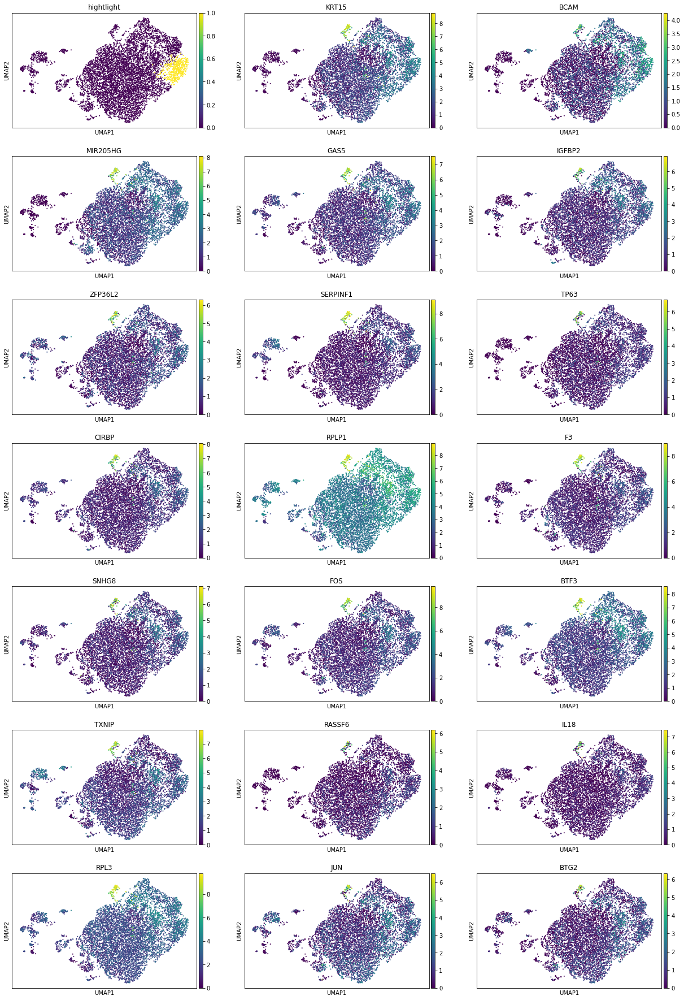

In [24]:
topgenes = list(DE["0"].T[:20].index)
organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == "0"
sc.pl.umap(
    organ_adata,
    color=["hightlight"] + topgenes,
    ncols=3,
)

You can do this for other clusters as well. Here I plot the top 5 genes for all other clusters

0


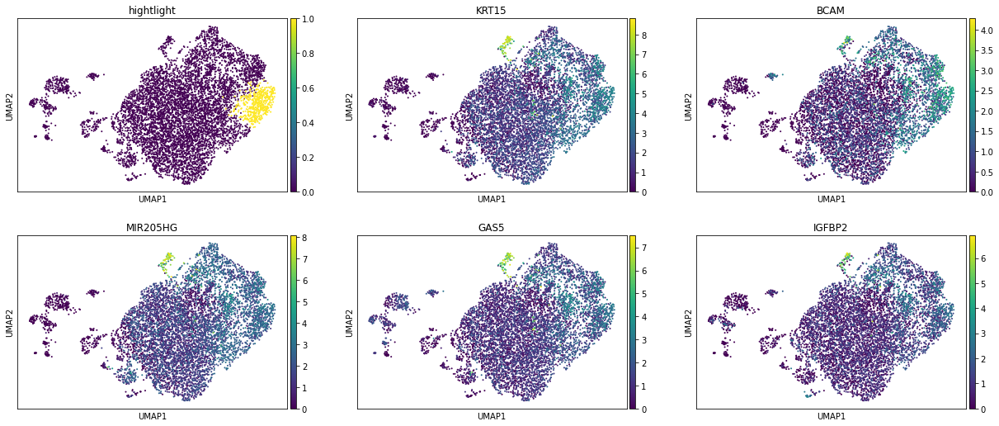

1


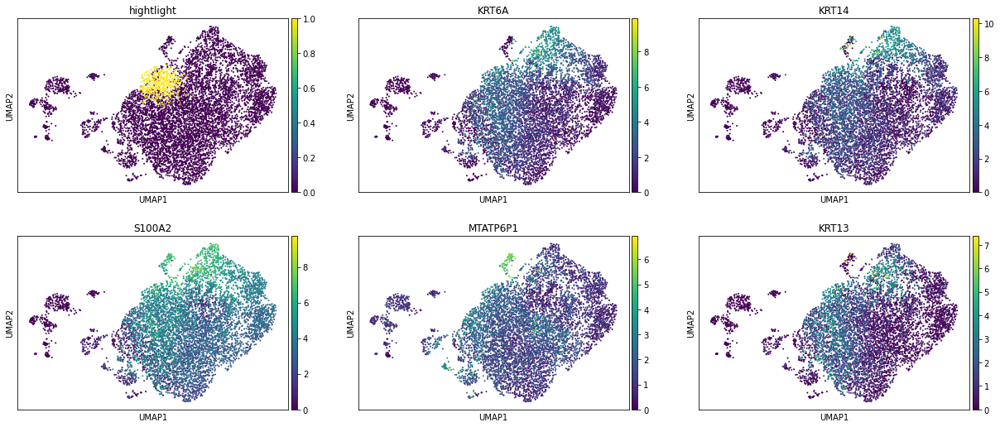

2


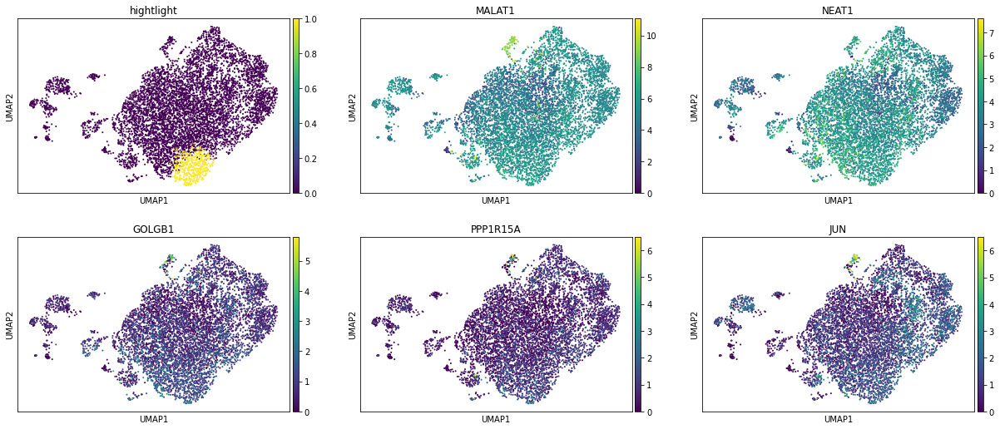

3


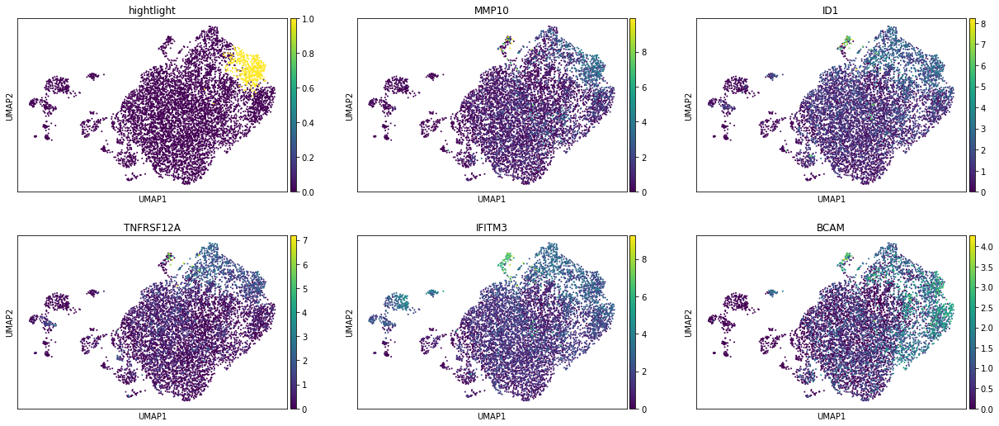

4


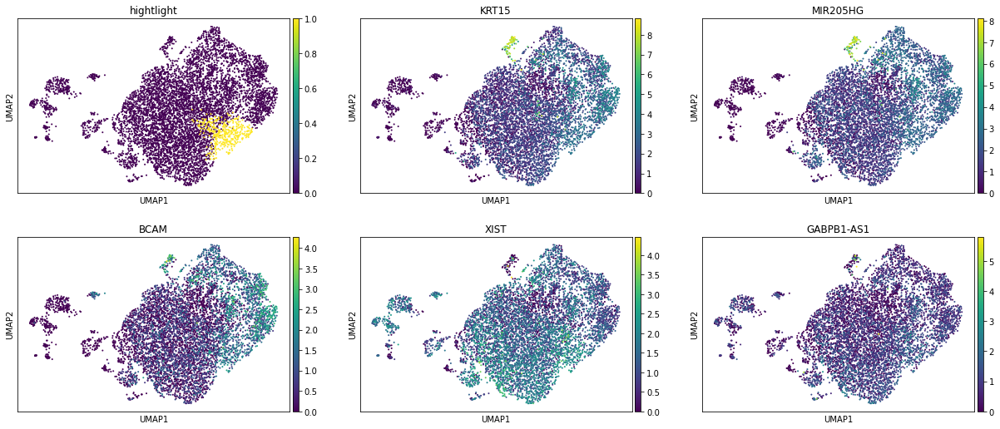

5


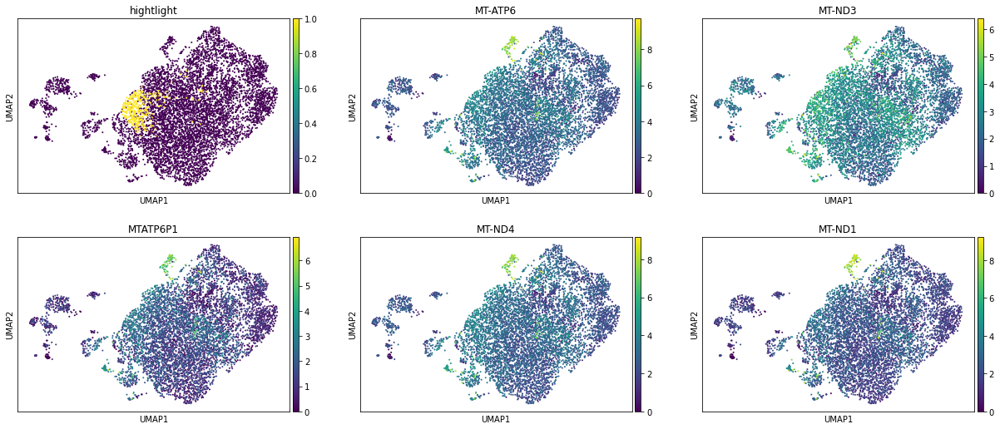

6


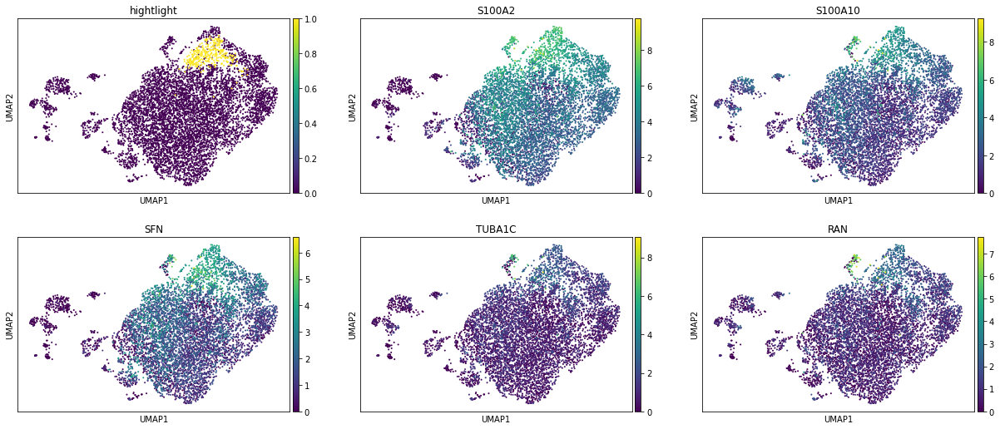

7


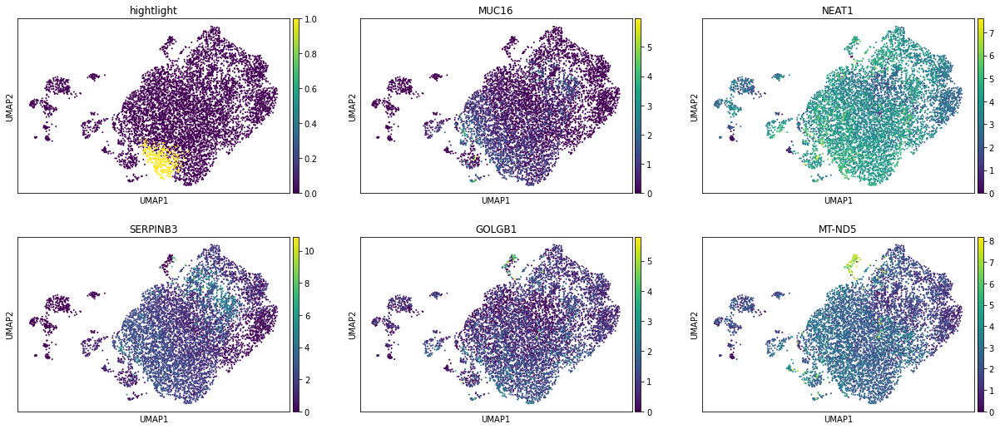

8


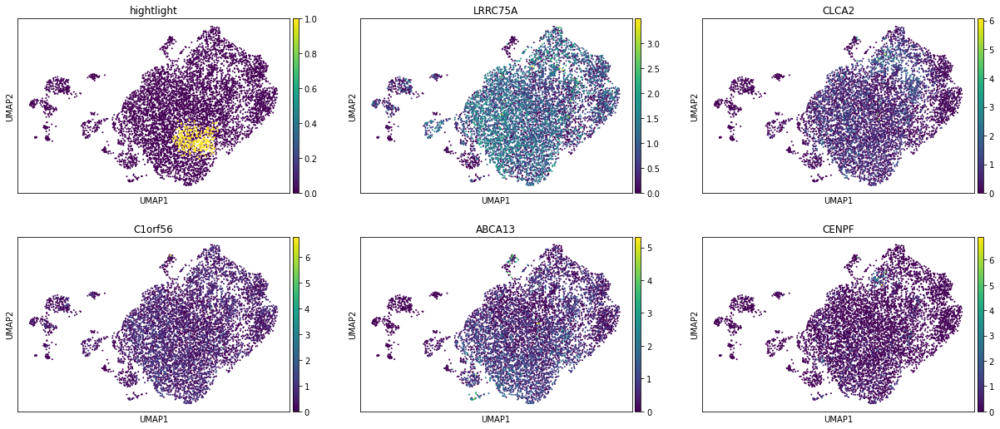

9


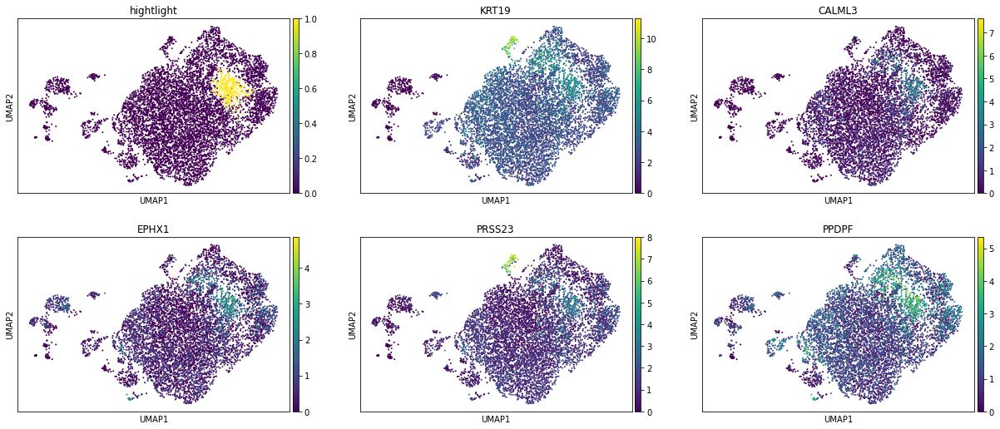

10


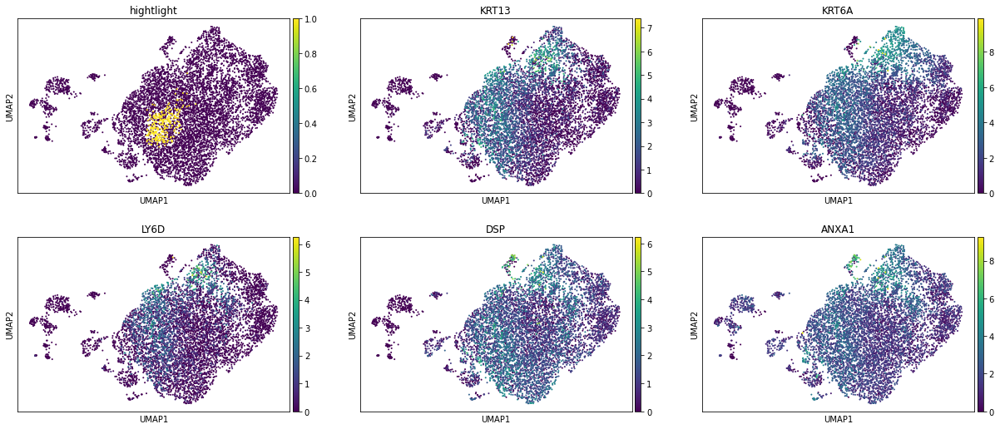

11


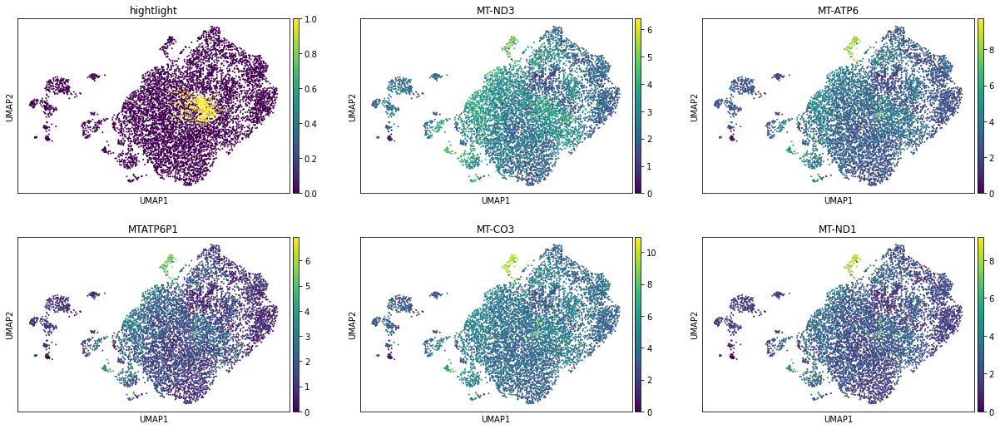

12


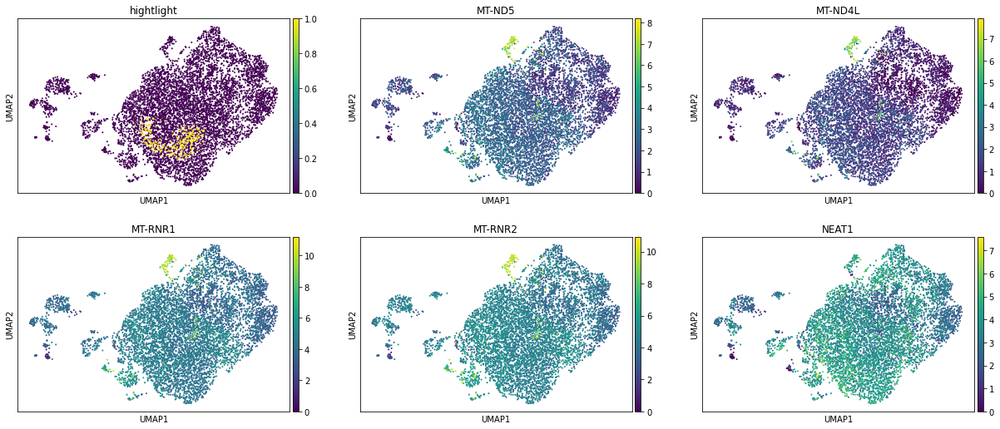

13


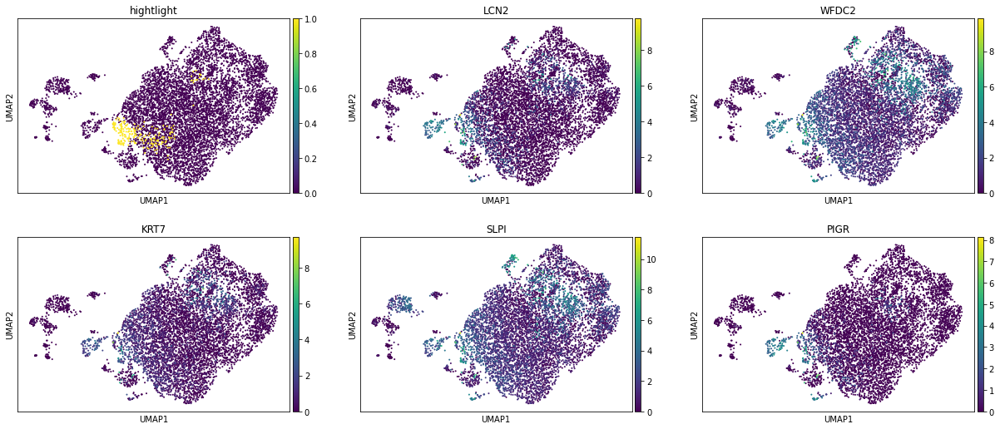

14


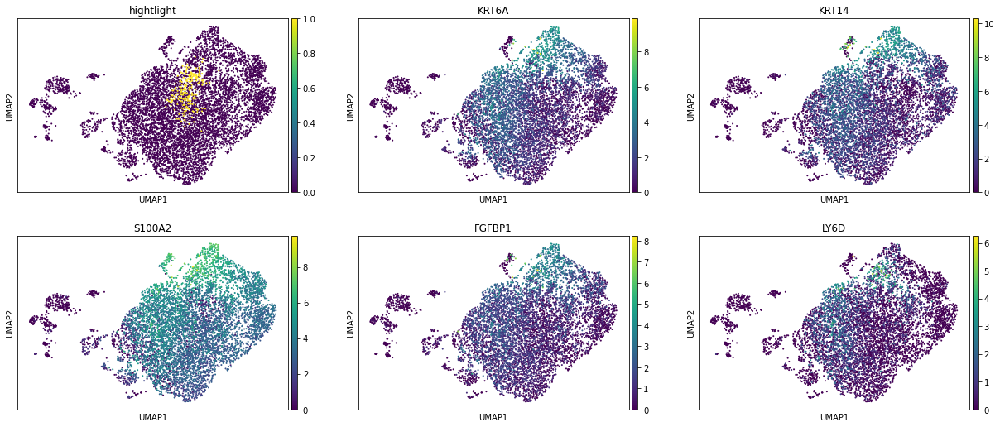

15


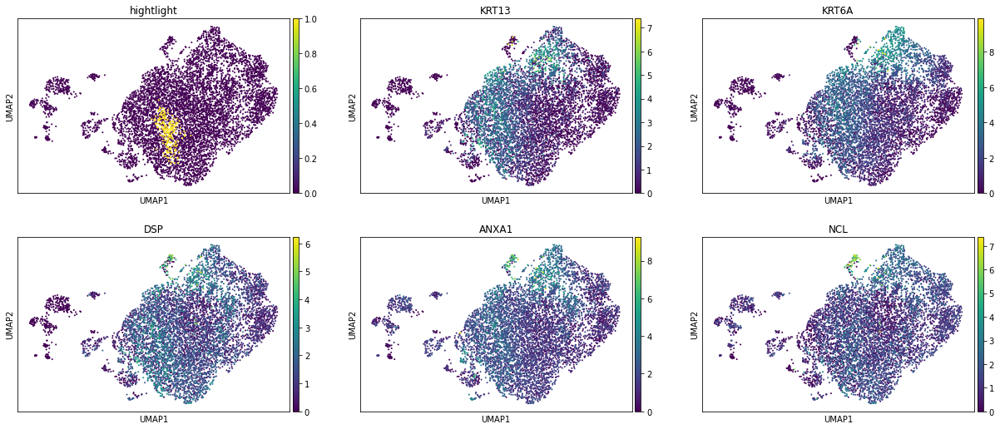

16


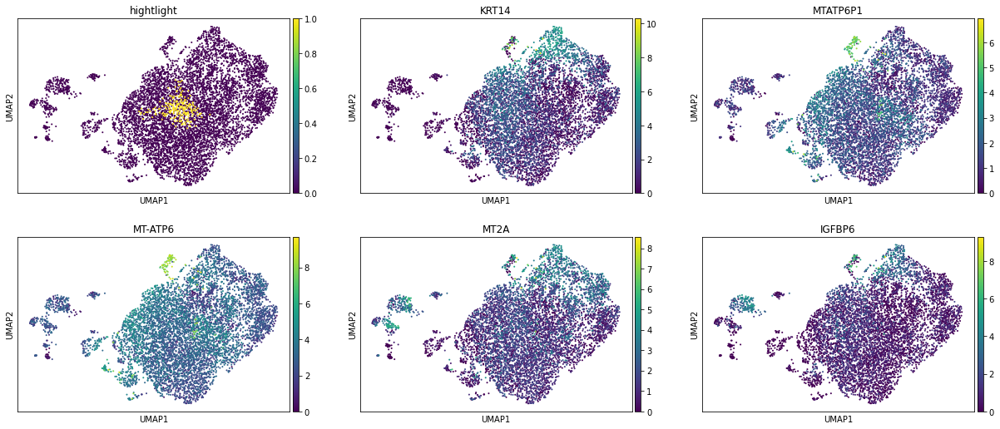

17


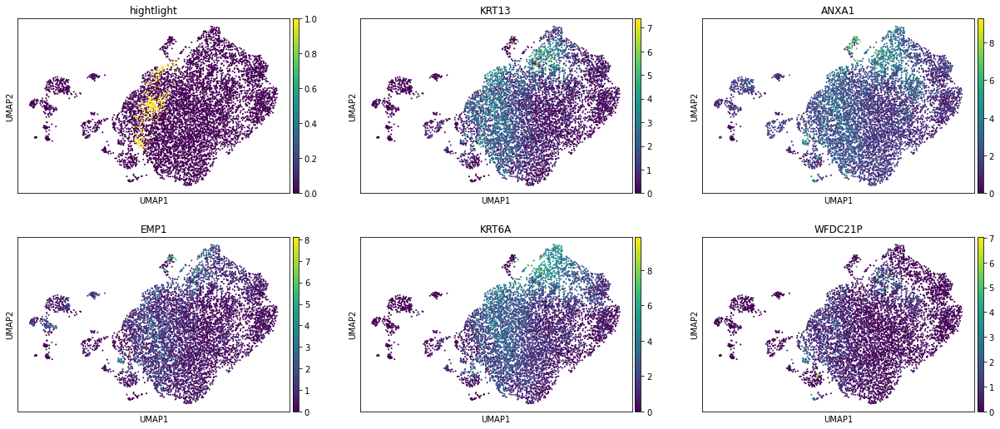

18


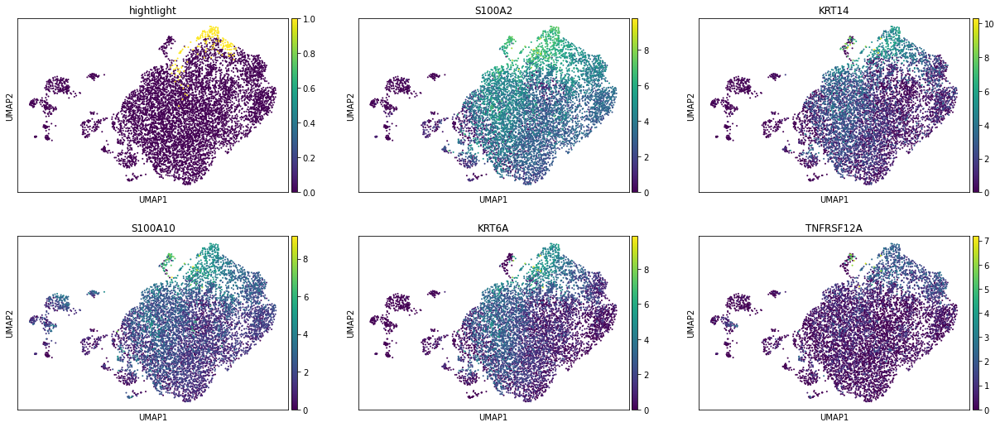

19


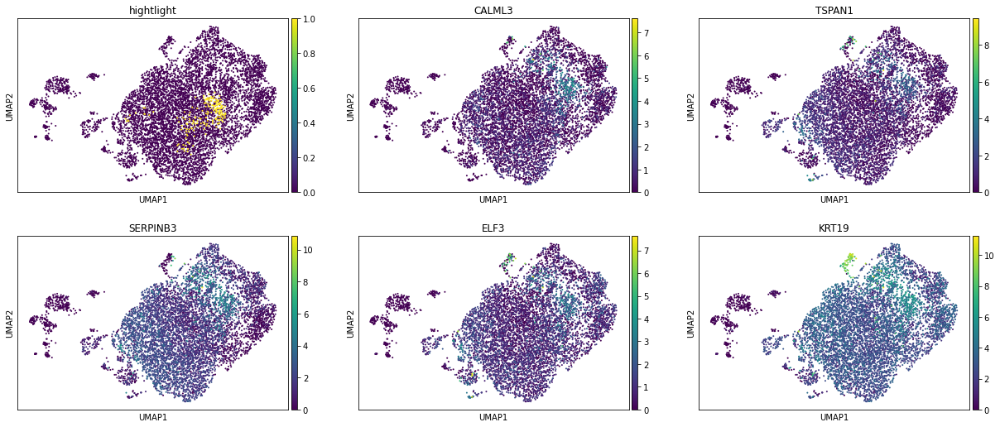

20


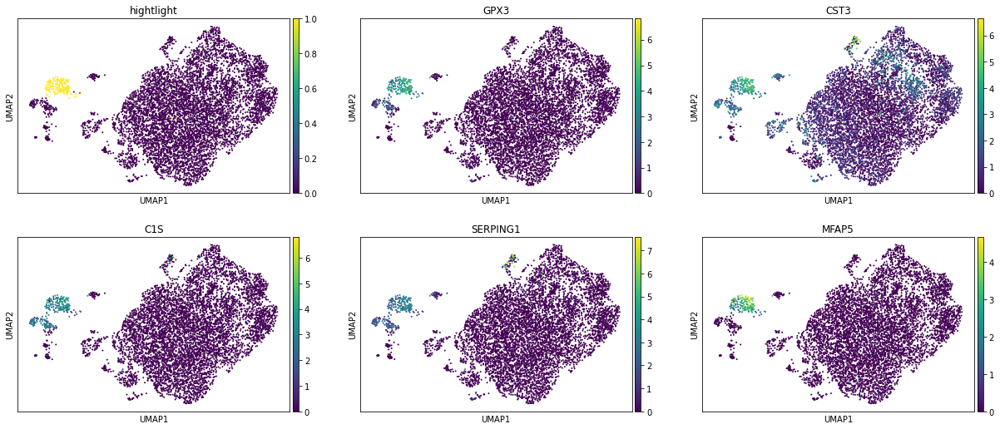

21


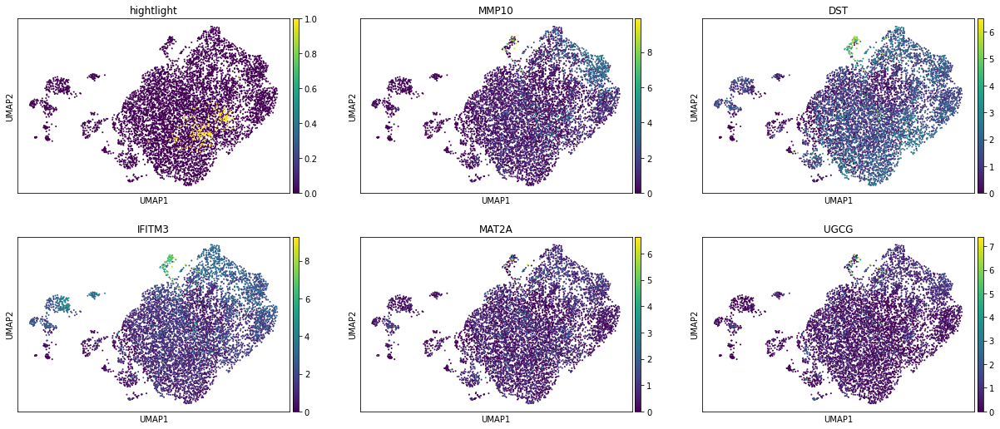

22


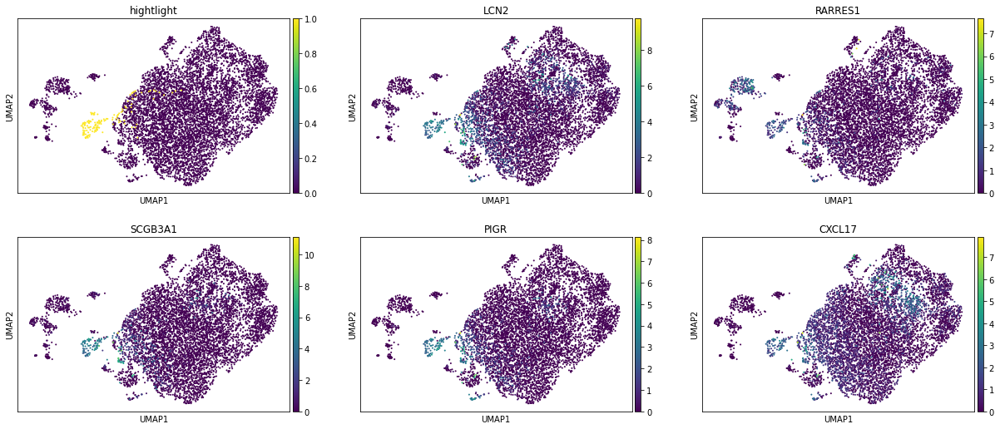

23


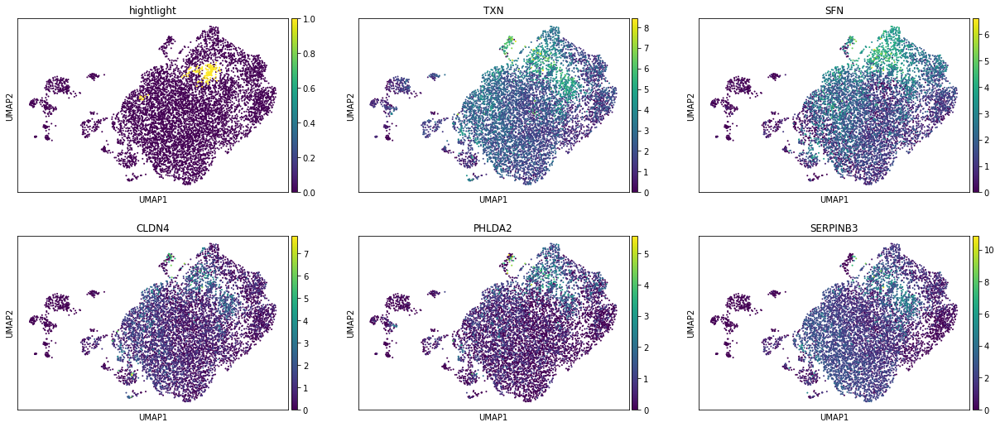

24


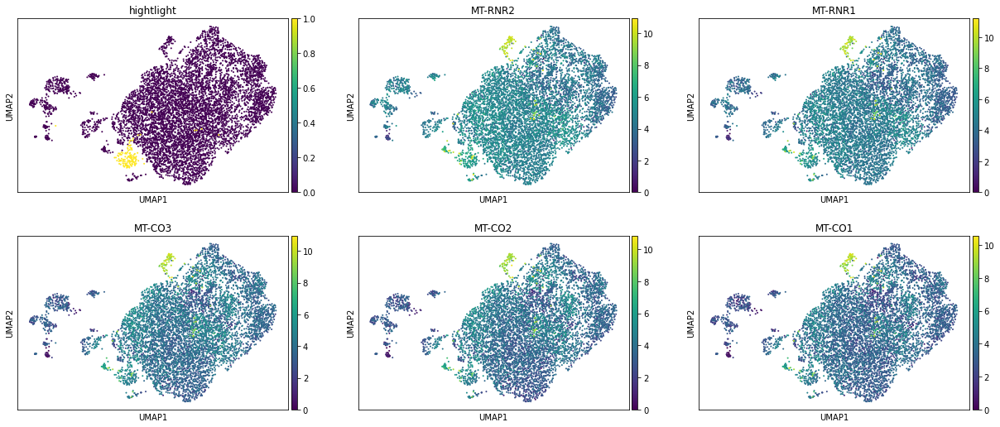

25


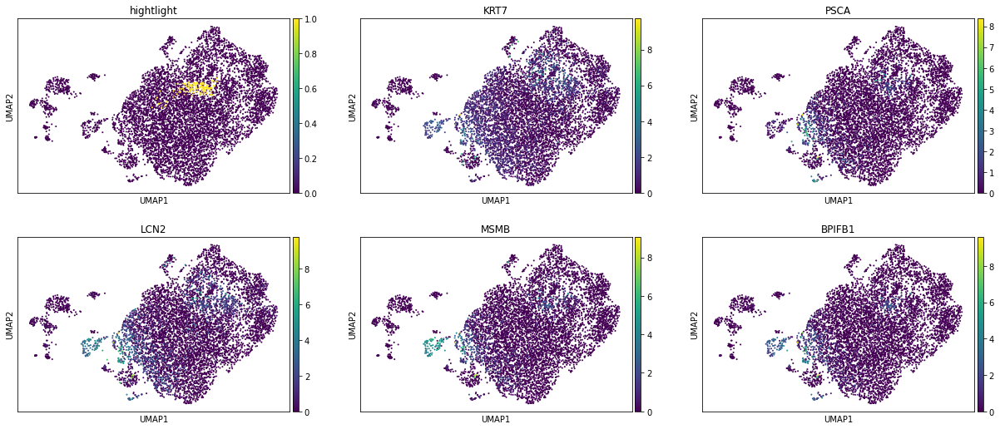

26


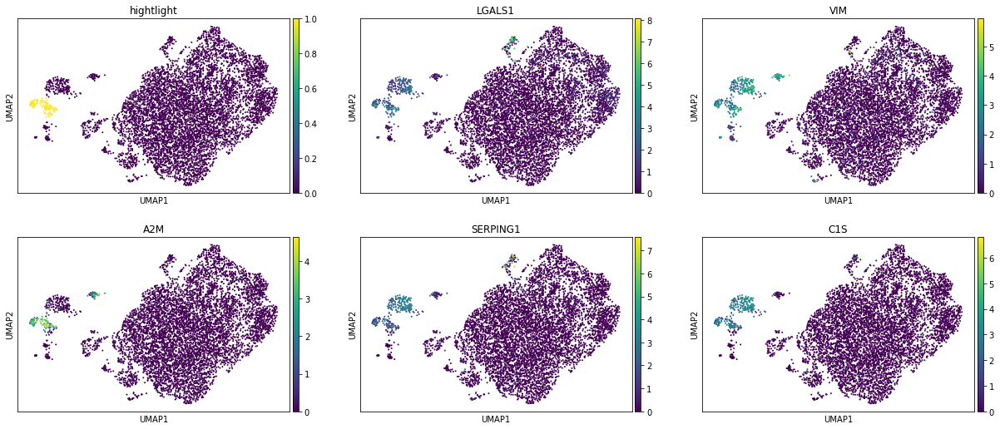

27


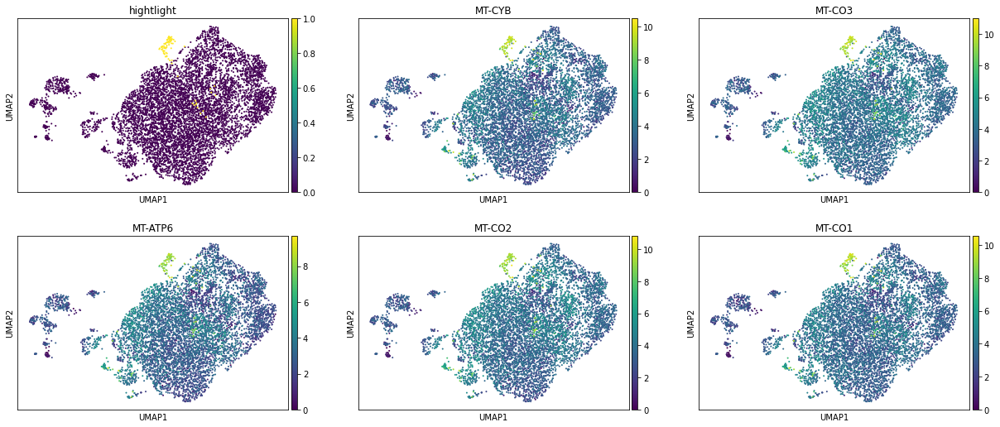

28


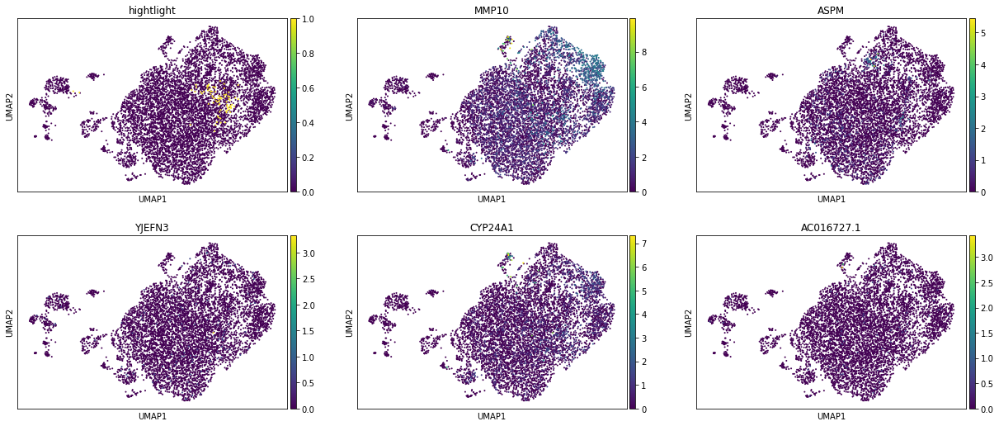

29


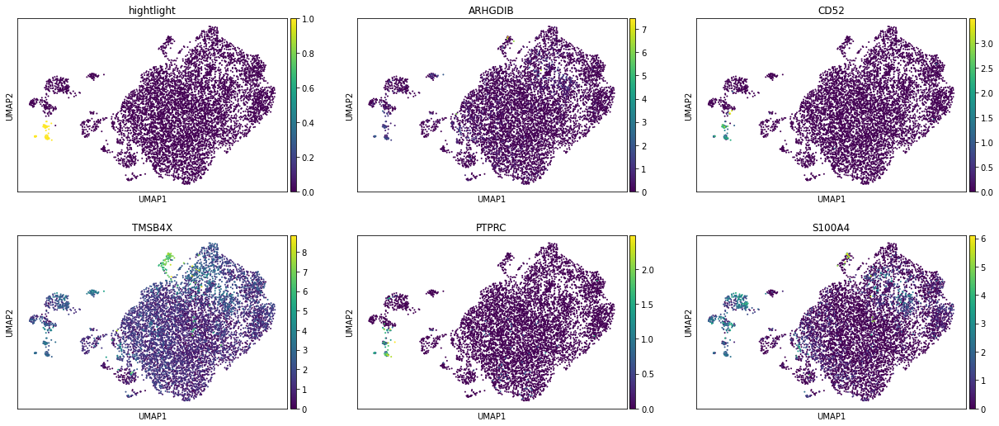

30


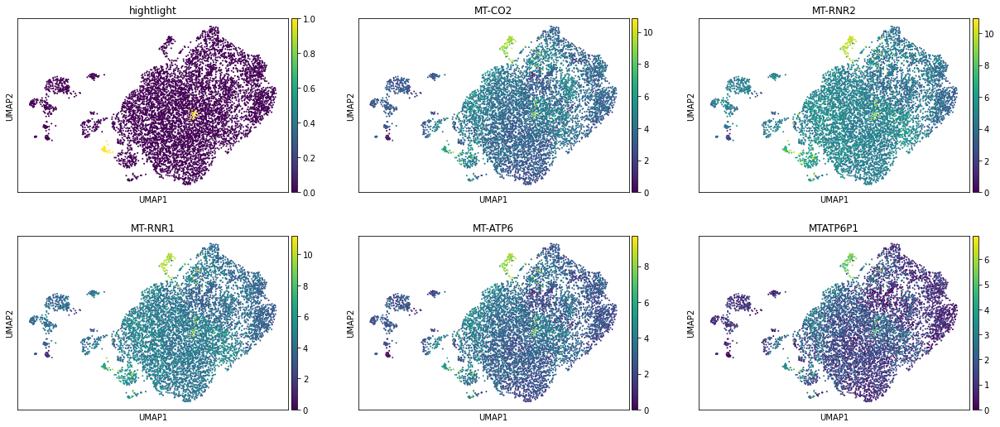

31


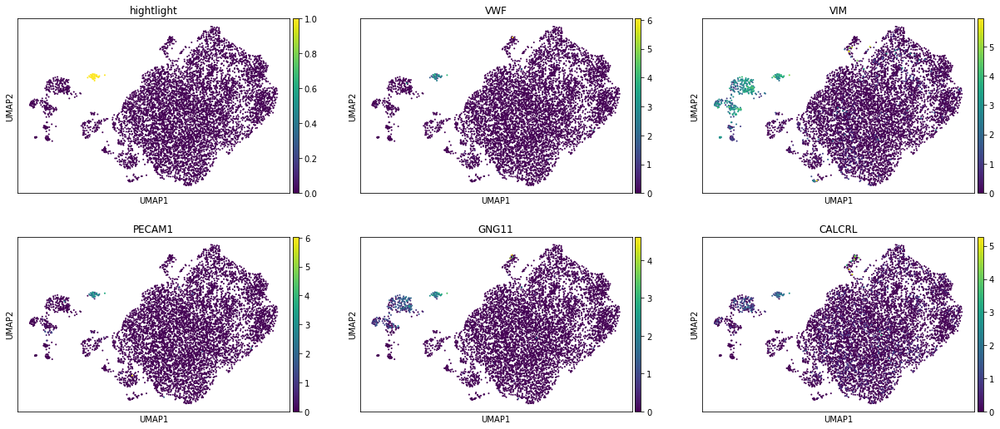

32


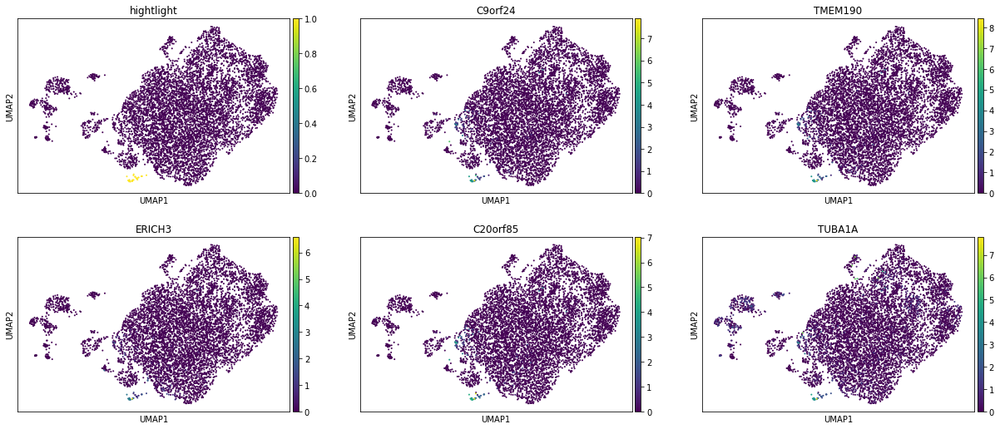

In [25]:
for x in DE.keys():
    print(x)
    topgenes = list(DE[x].T[:5].index)
    organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == x
    sc.pl.umap(
        organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

### The extended DE list can be queried by 

In [26]:
DE["0"].T

,wilcoxon_score,log fold change,adjusted pvalue
KRT15,24.350584,2.381454,1.682317e-126
BCAM,23.277498,2.268162,1.102942e-115
MIR205HG,19.550871,1.522509,2.170380e-81
GAS5,16.947042,1.453657,6.618898e-61
IGFBP2,16.836163,1.465742,4.107246e-60
...,...,...,...
MT-RNR2,-20.307266,-1.359295,9.327250e-88
NEAT1,-21.920534,-1.444360,1.623867e-102
MT-ND4L,-22.074936,-2.758762,6.480605e-104
MT-ND5,-23.414171,-1.908506,6.015230e-117


# read in cell ontology 

In [27]:
import obonet

ont_dir = "/data/yosef2/users/chenling/TabulaSapiensData/ontology/"
obo = ont_dir + "cl.obo.txt"
f = open(obo, "r")
co = obonet.read_obo(f)
f.close()

celltype_dict = {}
for x in co.nodes:
    celltype_dict[co.nodes[x]['name']] = x



You can look up all T cell by typing celltype_dict['T'] and using tab complete  

In [28]:
celltype_dict['T cell']

'CL:0000084'

You can also look at the names of all subsets of T cell that contains 'CD4' in their names

In [29]:
import networkx as nx


def PrintChildren(co, parent, pattern=""):
    all_children = [x for x in nx.ancestors(co, celltype_dict[parent])]
    return [co.nodes[x]["name"] for x in all_children if pattern in co.nodes[x]["name"]]


PrintChildren(co, "T cell", "CD4")

['CD4-positive helper T cell',
 'CD4-positive, alpha-beta cytotoxic T cell',
 'CD4-positive, alpha-beta T cell',
 'activated CD4-positive, alpha-beta T cell, human',
 'CD4-positive, alpha-beta memory T cell',
 'CD4-negative CD8-negative gamma-delta intraepithelial T cell',
 'CD4-negative, CD8-negative type I NK T cell secreting interferon-gamma',
 'CD4-negative, CD8-negative type I NK T cell',
 'effector memory CD4-positive, alpha-beta T cell',
 'CD4-positive type I NK T cell secreting interferon-gamma',
 'CD4-negative, CD8-negative type I NK T cell secreting interleukin-4',
 'CD69-positive, CD4-positive single-positive thymocyte',
 'activated CD4-positive, alpha-beta T cell',
 'CD24-positive, CD4 single-positive thymocyte',
 'CD4-positive, CD25-positive, CCR4-positive, alpha-beta regulatory T cell',
 'CD4-intermediate, CD8-positive double-positive thymocyte',
 'central memory CD4-positive, alpha-beta T cell',
 'CD4-negative, CD8-negative, alpha-beta intraepithelial T cell',
 'CD4-posi

# manually create mapping between cluster and cell type (this is just an example), and the relevant marker genes that was used to generate this prediction

In [30]:
organ_adata.obs["annotation_oct2020"] = organ_adata.obs["leiden"].copy()
cluster_mapping = {"0": "T cell"}
cluster_markers = {"0": ["CXCR4", "CD3D", "IL7R", "IL32"]}

This cell will automatically replace the leiden cluster names with cell type annotations

In [31]:
for l in cluster_mapping.keys():
    organ_adata.obs["annotation_oct2020"].replace(l, cluster_mapping[l], inplace=True)
    display(DE[l][cluster_markers[l]])

,CXCR4,CD3D,IL7R,IL32
wilcoxon_score,-0.229131,-0.136309,-0.959747,-0.795707
log fold change,-2.678915,-1.110477,-2.360709,-1.781857
adjusted pvalue,1.000000,1.000000,1.000000,1.000000


# Visualize the results of the manual annotation

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



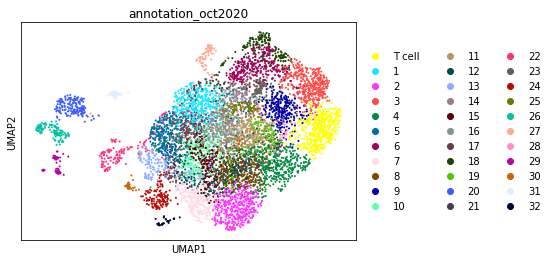

In [32]:
sc.pl.umap(
    organ_adata,
    color=["annotation_oct2020"],
    ncols=3,
)

# manually create mapping between cell type and compartment (this is just an example)

In [33]:
organ_adata.obs["compartment_oct2020"] = organ_adata.obs["annotation_oct2020"].copy()
compartment_mapping = {"T cell": "Immune"}

This cell will automatically replace the leiden cluster names with cell type annotations

In [34]:
for c in compartment_mapping.keys():
    organ_adata.obs["compartment_oct2020"].replace(
        c, compartment_mapping[c], inplace=True
    )

# Visualize the results of the new compartment splitting

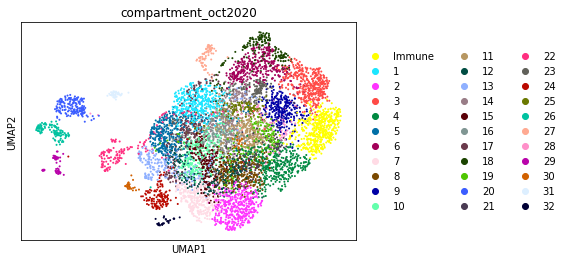

In [35]:
sc.pl.umap(
    organ_adata,
    color=["compartment_oct2020"],
    ncols=3,
)

# save data

In [36]:
organ_adata.write_h5ad(
    data_path + "decontX/organ_data/Pilot1_Pilot2.decontX.%s.h5ad" % organ
)